## Двух- и трехмерная визуализация структуры множества эмбеддингов BERT при помощи t-SNE

In [1]:
import os
import pandas as pd
import numpy as np
import pickle
import warnings
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

warnings.filterwarnings('ignore')

Загружаем исходные данные, полученные ранее

In [2]:
# Эмбеддинги, полученные моделью BERT
with open("BERT_embeds.pkl", "rb") as file_to_read:
    corpus_embeds = pickle.load(file_to_read)
    

In [3]:
# Имена текстовых файлов с распознанными разговорами
with open("embedded_file_names.pkl", "rb") as file_to_read:
    embedded_file_names = pickle.load(file_to_read)

In [4]:
# Модовые темы каждого файла
with open("text_topic_mapping.pkl", "rb") as file_to_read:
    text_topic_mapping = pickle.load(file_to_read)

In [5]:
corpus_embeds_np = np.asarray(corpus_embeds)

In [6]:
corpus_embeds_np.shape

(61200, 768)

#### Двумерная визуализация

In [7]:
def compute_2d(embeddings, metric='cosine', learning_rate=200):
    model = TSNE(learning_rate=learning_rate, metric=metric)
    return model.fit_transform(embeddings)

In [8]:
embeddings_2d = compute_2d(corpus_embeds, 'cosine', 50)

In [9]:
# Назначаем цвета в соответствии с модовой темой
colors=[]
for file_name in embedded_file_names:
    topic = int(text_topic_mapping[text_topic_mapping['file_name'] == file_name]['topic'])
    colors.append(topic)

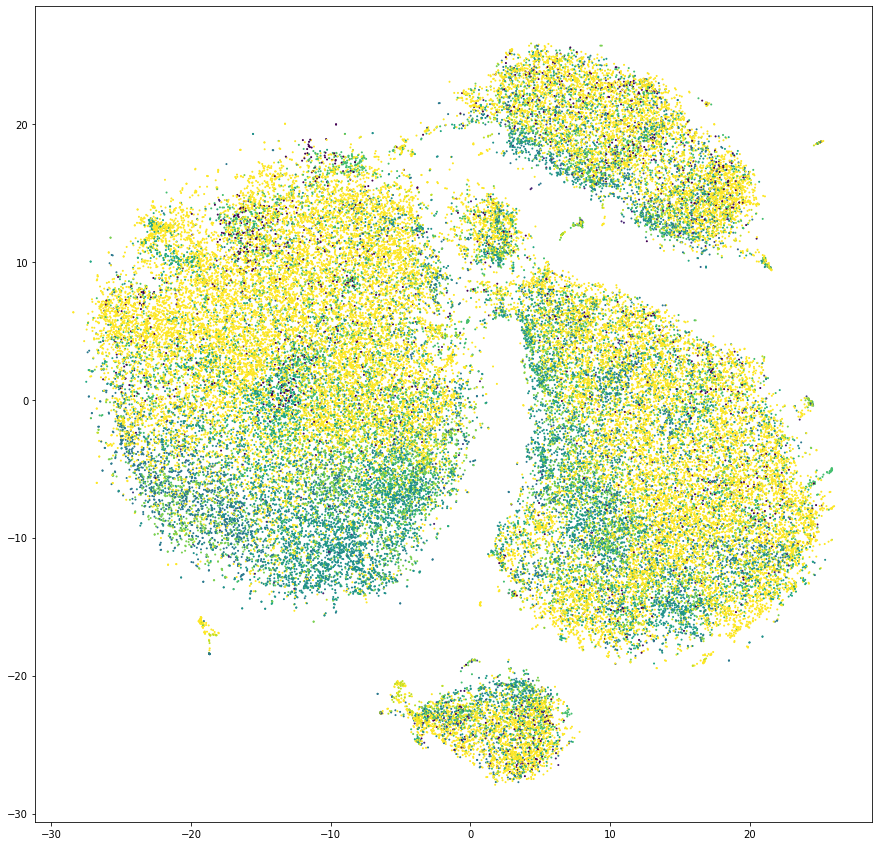

In [10]:
plt.figure(figsize=(15,15))
x, y = embeddings_2d[:, 0], embeddings_2d[:, 1]
plt.scatter(x, y, 1, c=colors)
plt.show()

#### Трехмерная визуализация

In [11]:
def compute_3d(embeddings, metric='cosine',learning_rate=200):
    model = TSNE(n_components=3, metric=metric, learning_rate=learning_rate, square_distances=True, init='pca')
    return model.fit_transform(embeddings)

In [12]:
embeddings_3d = compute_3d(corpus_embeds, learning_rate=100)

In [13]:
x, y, z = embeddings_3d[:, 0], embeddings_3d[:, 1], embeddings_3d[:, 2]

In [14]:
fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z,
                                   mode='markers', 
                                   marker=dict(
                                        size=1,
                                        color=colors,
                                        opacity=0.8
                                    )
                                  )
                     ], 
                layout={'height':1000, 'width':1000}
               )
fig.show()

In [15]:
with open("BERT_embeds.pkl", "rb") as file_to_read:
    corpus_embeds = pickle.load(file_to_read)

In [16]:
embeddings_3d = compute_3d(corpus_embeds, learning_rate=50)

In [17]:
x, y, z = embeddings_3d[:, 0], embeddings_3d[:, 1], embeddings_3d[:, 2]


In [18]:
fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z,
                                   mode='markers', 
                                   marker=dict(
                                        size=1,
                                        color='blue',                # set color to an array/list of desired values
                                        colorscale='Viridis',   # choose a colorscale
                                        opacity=0.8
                                    )
                                  )
                      
                     ], 
                layout={'height':1000, 'width':1000}
               )
fig.show()

## Поиск аномалий

In [22]:
from sklearn.base import BaseEstimator
from scipy.spatial.distance import cdist
from sklearn.preprocessing import RobustScaler

class DistanceOutliers(BaseEstimator):
    
    def __init__(self, metric='euclidean', percentile=90):
        self.metric = metric
        self.percentile = percentile
        
    def fit(self, X):
        self.centroid = np.mean(X, axis=0).values.reshape(-1, 1).T
        distances_train = cdist(self.centroid, X, metric=self.metric).reshape(-1)
        self.threshold = np.percentile(distances_train, self.percentile)
        
    def predict(self, X):
        distances = cdist(self.centroid, X, metric=self.metric).reshape(-1)
        predictions = (distances > self.threshold).astype(int)
        return predictions

In [23]:
def anomalies_report(outliers):
    print("Total number of outliers: {}\nPercentage of outliers:   {:.2f}%".format(
            sum(outliers), 100*sum(outliers)/len(outliers)))

In [24]:
euclidian_model = DistanceOutliers(metric='euclidean', percentile=98)
euclidian_model.fit(pd.DataFrame(corpus_embeds_np))
euclidian_outliers = euclidian_model.predict(corpus_embeds_np)
anomalies_report(euclidian_outliers)



Total number of outliers: 1224
Percentage of outliers:   2.00%


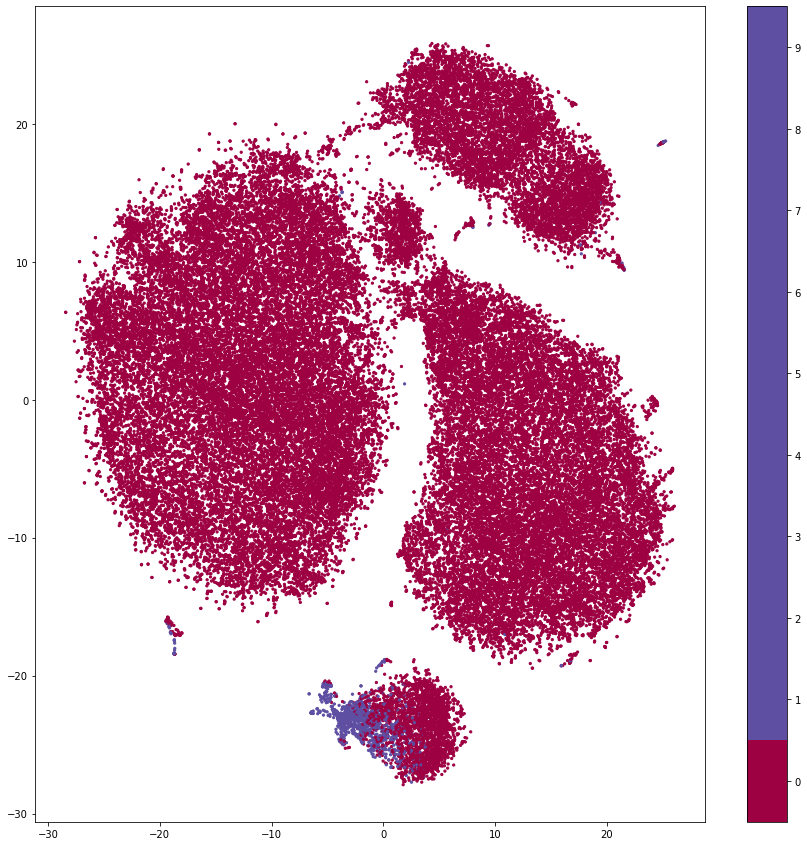

In [27]:
plt.figure(figsize=(15,15))
plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], c=euclidian_outliers, cmap='Spectral', s=5)
plt.colorbar(boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.show()


In [10]:
with open('anomaly.pkl', 'wb') as f:
    pickle.dump(euclidian_outliers, f)

In [26]:
citiblock_model = DistanceOutliers(metric='cityblock', percentile=98)
citiblock_model.fit(pd.DataFrame(corpus_embeds_np))
cityblock_outliers = citiblock_model.predict(pd.DataFrame(corpus_embeds_np))
anomalies_report(cityblock_outliers)

Total number of outliers: 1224
Percentage of outliers:   2.00%


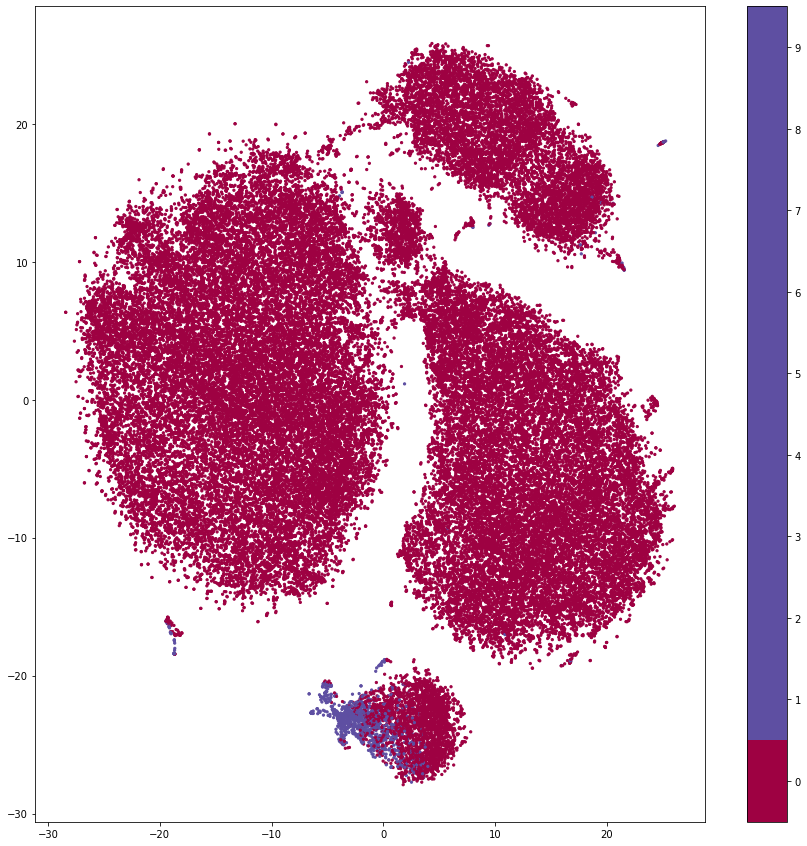

In [28]:
plt.figure(figsize=(15,15))
plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], c=cityblock_outliers, cmap='Spectral', s=5)
plt.colorbar(boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.show()


## Кластеризация

In [29]:
from sklearn.cluster import KMeans
clustering =  KMeans(n_clusters=6)
classes = clustering.fit_predict(corpus_embeds_np)

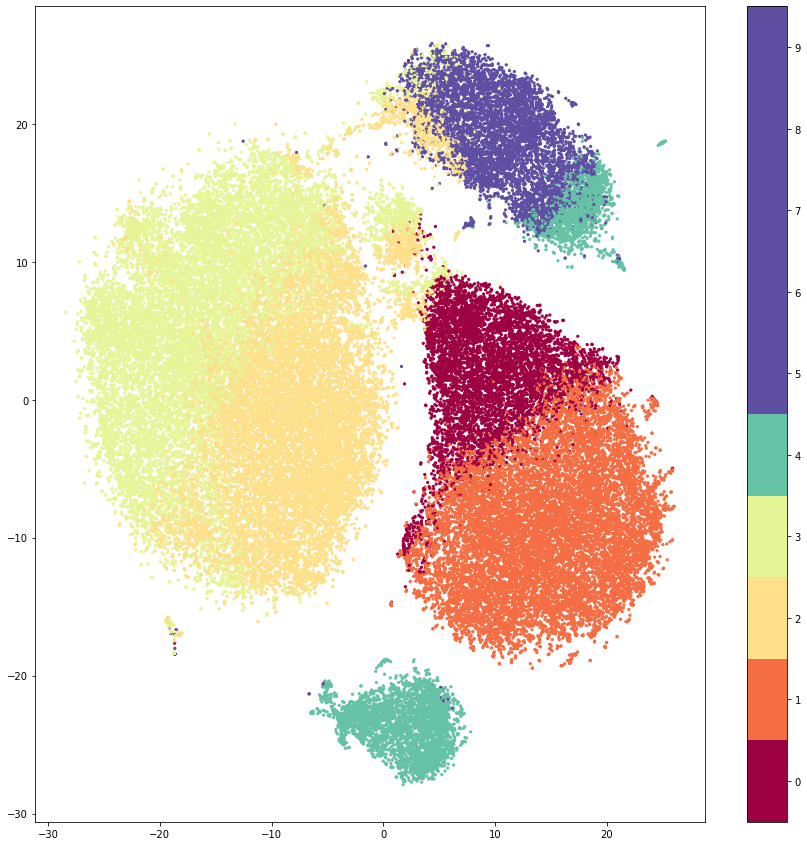

In [31]:
plt.figure(figsize=(15,15))
plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], c=classes, cmap='Spectral', s=5)
plt.colorbar(boundaries=np.arange(11)-0.5).set_ticks(np.arange(10))
plt.show()

In [42]:
with open('Classes_KMeans.pkl', 'wb') as f:
    pickle.dump(classes, f)

## Метрики качества

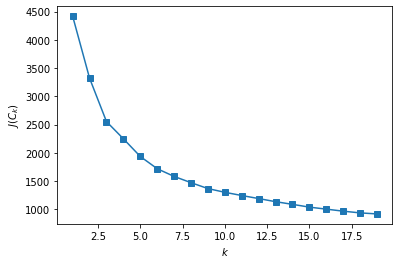

In [11]:
inertia = []
for k in range(1, 20):
    kmeans = KMeans(n_clusters=k, random_state=1).fit(embeddings_2d)
    inertia.append(np.sqrt(kmeans.inertia_))

plt.plot(range(1, 20), inertia, marker='s');
plt.xlabel('$k$')
plt.ylabel('$J(C_k)$');


In [33]:
from sklearn import metrics
from sklearn import datasets
import pandas as pd
from sklearn.cluster import KMeans

algorithms = []
col = []
for i in range(2,20):
    algorithms.append(KMeans(n_clusters=i, random_state=1))
    col.append(i)

data = []
for algo in algorithms:
    algo.fit(embeddings_2d)
    data.append(({
        'Silhouette': metrics.silhouette_score(embeddings_2d, algo.labels_)}))

results = pd.DataFrame(data=data, index=[col])


,Silhouette
2,0.418840
3,0.465959
4,0.425708
5,0.406512
6,0.405710
7,0.407721
8,0.412569
9,0.407286
10,0.403178
11,0.397187


,Silhouette
2,0.399866
3,0.433335
4,0.413476
5,0.410754
6,0.420367
7,0.419566
8,0.400776
9,0.408746
10,0.399860
11,0.391290


In [39]:
a = range(2,20)
b = [0.399866,
0.433335,
0.413476,
0.410754,
0.420367,
0.419566,
0.400776,
0.408746,
0.399860,
0.391290,
0.392798,
0.396346,
0.384107,
0.389695,
0.389575,
0.387698,
0.389259,
0.385950]

([<matplotlib.axis.XTick at 0x7ffa8cea5310>,
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

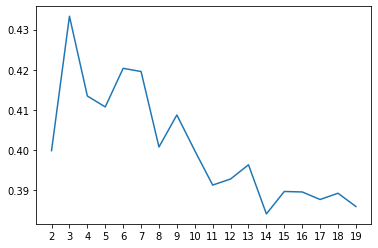

In [41]:
plt.plot(a,b)
plt.xticks(a)